In [2]:
import cv2 
import numpy as np 
import matplotlib.pyplot as plt
import cvlib as cv
from cvlib.object_detection import draw_bbox
import imutils
import os
import time

# Cartoonifying an Image

https://www.geeksforgeeks.org/cartooning-an-image-using-opencv-python/

<Figure size 432x288 with 0 Axes>

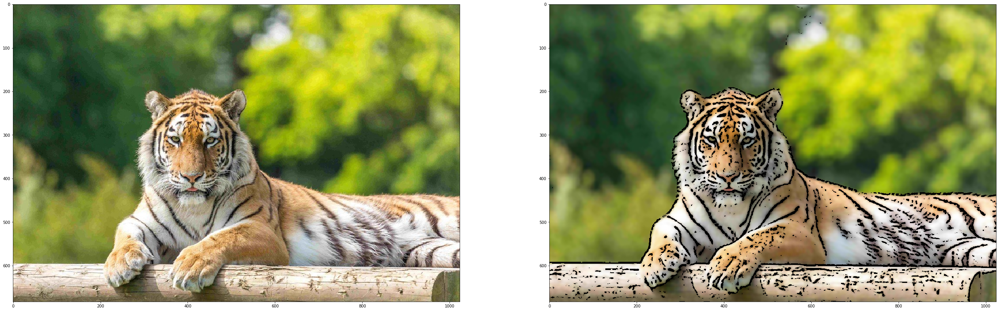

<Figure size 432x288 with 0 Axes>

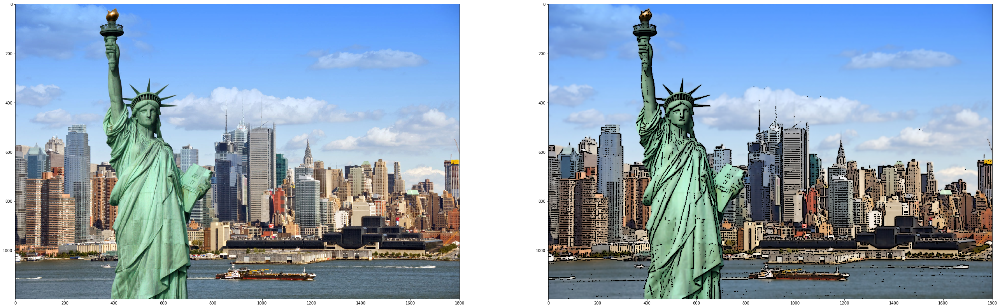

<Figure size 432x288 with 0 Axes>

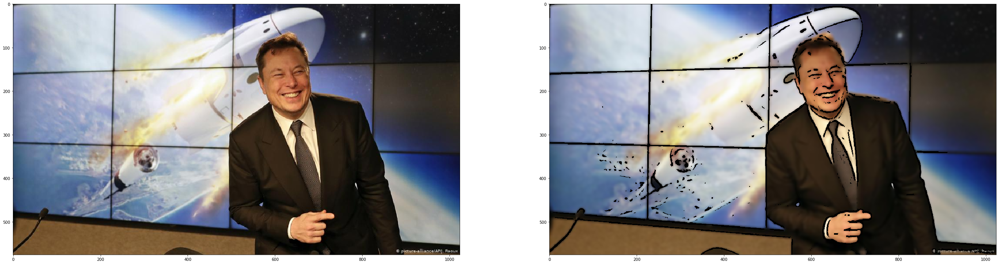

<Figure size 432x288 with 0 Axes>

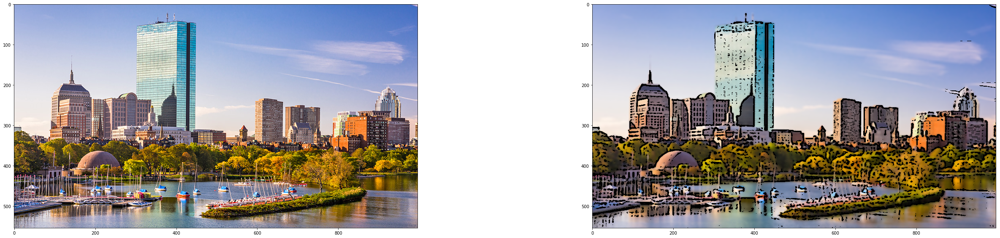

In [12]:
for x in range(1, 5):
    
    # Reading image  
    img = cv2.imread("img\\cartoon_" + str(x) + '.jpg') 

    # Edges 
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
    gray = cv2.medianBlur(gray, 5) 
    edges = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 9, 9) 

    # Cartoonization 
    color = cv2.bilateralFilter(img, 9, 250, 250) 
    cartoon = cv2.bitwise_and(color, color, mask=edges) 

    plt.figure()
    plt.figure(figsize=[45,45])
    plt.subplot(x,2,1),plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) 
    plt.subplot(x,2,2),plt.imshow(cv2.cvtColor(cartoon, cv2.COLOR_BGR2RGB)) 

# Watercolor Effect 
https://towardsdatascience.com/painting-and-sketching-with-opencv-in-python-4293026d78b

<Figure size 432x288 with 0 Axes>

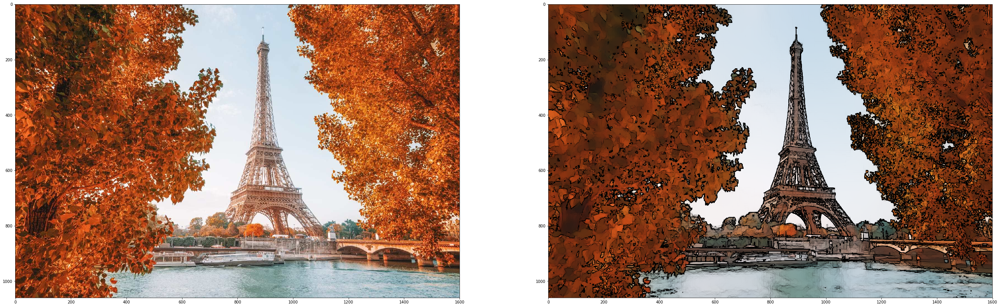

<Figure size 432x288 with 0 Axes>

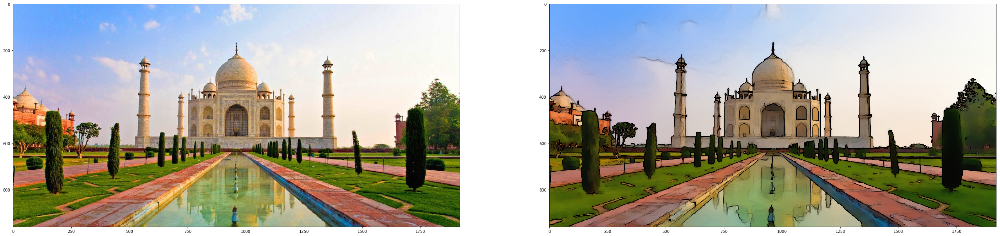

<Figure size 432x288 with 0 Axes>

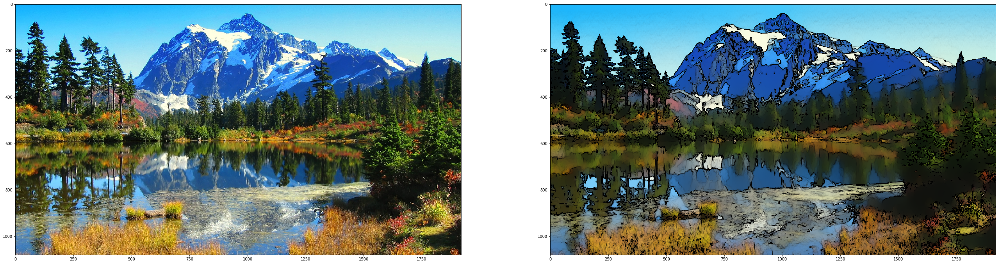

<Figure size 432x288 with 0 Axes>

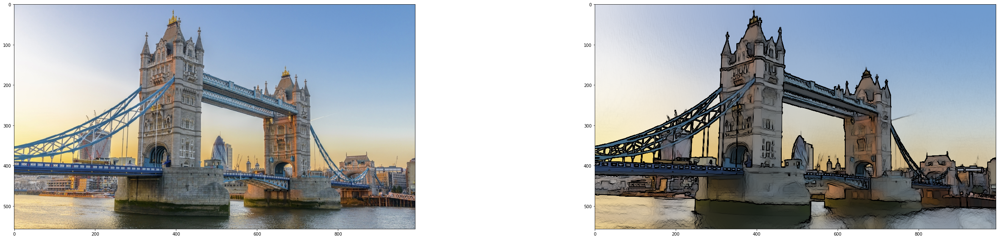

In [5]:
for x in range(1,5):
    
    # Reading image  
    img = cv2.imread("img\\wtr_" + str(x) + '.jpg') 
    
    # sigma_s controls the size of the neighborhood. Range 1 - 200
    # sigma_r controls the how dissimilar colors within the neighborhood will be averaged. A larger sigma_r results in large regions of constant color. Range 0 - 1
    res = cv2.stylization(img, sigma_s=60, sigma_r=0.6)

    plt.figure()
    plt.figure(figsize=[45,45])
    plt.subplot(x,2,1),plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) 
    plt.subplot(x,2,2),plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

# Pop Art Effect 

https://www.analytics-link.com/post/2019/07/11/creating-pop-art-using-opencv-and-python

![title](popartdemo.png)


In [4]:
# set colours (BGR)
background_colour = [0, 251, 255]
dots_colour = (196, 0, 108)

# set the max dots (on the longest side of the image)
max_dots = 500

for xy in range(1,5):
    
    # import the image as greyscale
    original_image = cv2.imread('img\\wtr_' + str(xy) + '.jpg', 0)
    
    # extract dimensions
    original_image_height, original_image_width = original_image.shape

    # down size to number of dots
    if original_image_height == max(original_image_height,original_image_width):
        downsized_image = cv2.resize(original_image,(int(original_image_height*(max_dots/original_image_width)),max_dots))
    else:
        downsized_image = cv2.resize(original_image,(max_dots,int(original_image_height*(max_dots/original_image_width))))

    # extract dimensions of new image
    downsized_image_height, downsized_image_width = downsized_image.shape

    # set how big we want our final image to be
    multiplier = 25

    # set the size of our blank canvas
    blank_img_height = downsized_image_height * multiplier
    blank_img_width = downsized_image_width * multiplier

    # set the padding value so the dots start in frame (rather than being off the edge
    padding = int(multiplier/2)

    # create canvas containing just the background colour
    blank_image = np.full(((blank_img_height),(blank_img_width),3), background_colour,dtype=np.uint8)

    # run through each pixel and draw the circle on our blank canvas
    for y in range(0,downsized_image_height):
        for x in range(0,downsized_image_width):
            cv2.circle(blank_image,(((x*multiplier)+padding),((y*multiplier)+padding)), int((0.6 * multiplier) * ((255-downsized_image[y][x])/255)), dots_colour, -1)

    # save our image
    cv2.imwrite('wtr_popart_' + str(xy) + '.png', blank_image)
    print('Saved as wtr_popart_' + str(xy) + '.png')

Saved as wtr_popart_1.png
Saved as wtr_popart_2.png
Saved as wtr_popart_3.png
Saved as wtr_popart_4.png
